## janesick_nature_comms_2023, scRNA

In [7]:
import time
from pathlib import Path
proj_name = "janesick_nc_2023_scRNAxenium"
save_dir = f"../save/dev_{proj_name}-{time.strftime('%b%d')}/"
save_dir = Path(save_dir)
save_dir.mkdir(parents=True, exist_ok=True)

data_dir = f"../data/janesick_nature_comms_2023/"
data_dir = Path(data_dir)

file_suffix = f"{time.strftime('%b%d-%H%M')}"
file_suffix

'Jun06-1232'

### Load corresponding adata

In [8]:
import scanpy as sc
scRNA_adata = sc.read_h5ad(data_dir / "scRNA_adata_Jun06-1218.h5ad")
xenium_adata = sc.read_h5ad(data_dir / "xenium_adata_Jun05-1233.h5ad")

/opt/anaconda3/envs/concord/lib/python3.12/site-packages/matplotlib_venn/_venn2.py:162: UserWarning: normalize_to is deprecated. Please use layout_algorithm=matplotlib_venn.layout.venn2.DefaultLayoutAlgorithm(normalize_to) instead.
  warnings.warn(


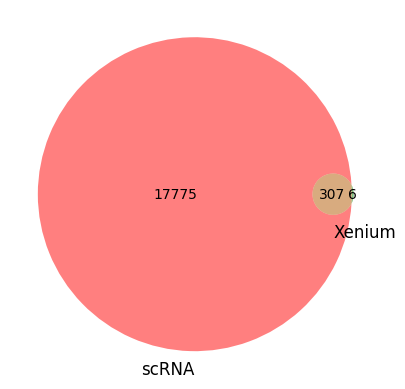

In [9]:
# Check gene overlap with venn diagram
from matplotlib_venn import venn2
import matplotlib.pyplot as plt
genes = [set(scRNA_adata.var_names), set(xenium_adata.var_names)]
venn2(genes, 
      set_labels=('scRNA', 'Xenium'),
      alpha=0.5,
      normalize_to=1.0,
      ax=None)
plt.savefig(save_dir / f"venn_genes_{file_suffix}.png")
plt.show()
plt.close()

In [10]:

adata = scRNA_adata.concatenate(xenium_adata)
adata.shape

/var/folders/wl/5x49grmn56v77c01bw965mj00000gn/T/ipykernel_7439/4153262838.py:1: FutureWarning: Use anndata.concat instead of AnnData.concatenate, AnnData.concatenate is deprecated and will be removed in the future. See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  adata = scRNA_adata.concatenate(xenium_adata)


(352254, 307)

In [38]:
# Filter out cells with too few genes
sc.pp.filter_cells(adata, min_genes=10)
print(f"Cells after filtering: {adata.shape[0]}")

Cells after filtering: 337958


In [39]:
# Normalize visium_adata
adata.X = adata.layers['counts'].copy()
sc.pp.normalize_total(adata, target_sum=1e4)
# log transform
sc.pp.log1p(adata)

In [40]:
# PCA and UMAP
n_latent = 50
sc.pp.pca(adata, n_comps=n_latent, svd_solver='arpack')
sc.pp.neighbors(adata, n_neighbors=15, n_pcs=n_latent)
sc.tl.umap(adata, min_dist=0.1, n_components=2)
sc.tl.leiden(adata, resolution=0.5, key_added='leiden', random_state=42)

In [41]:
xenium_adata

AnnData object with n_obs × n_vars = 286532 × 313
    obs: 'x_centroid', 'y_centroid', 'transcript_counts', 'control_probe_counts', 'control_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'Cluster', 'annot_cell_type', 'replicate'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'annot_cell_type_colors', 'celltype_annot_unsup_colors', 'log1p', 'neighbors', 'pca', 'replicate_colors', 'umap'
    obsm: 'Concord', 'Concord_UMAP', 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'connectivities', 'distances'

In [42]:
adata.obs_names

Index(['frp_AAACAAGCAAACGGGA-1-0-0', 'frp_AAACAAGCAAATAGGA-1-0-0',
       'frp_AAACAAGCAAATGACT-1-0-0', 'frp_AAACAAGCAACAAGTT-1-0-0',
       'frp_AAACAAGCAACCATTC-1-0-0', 'frp_AAACAAGCAACTAAAC-1-0-0',
       'frp_AAACAAGCAAGTCGCG-1-0-0', 'frp_AAACAAGCAATACCCT-1-0-0',
       'frp_AAACAAGCAATGGGAG-1-0-0', 'frp_AAACAAGCACAAGCGT-1-0-0',
       ...
       'xenium_rep2_118743-rep2-1', 'xenium_rep2_118744-rep2-1',
       'xenium_rep2_118745-rep2-1', 'xenium_rep2_118746-rep2-1',
       'xenium_rep2_118747-rep2-1', 'xenium_rep2_118748-rep2-1',
       'xenium_rep2_118749-rep2-1', 'xenium_rep2_118750-rep2-1',
       'xenium_rep2_118751-rep2-1', 'xenium_rep2_118752-rep2-1'],
      dtype='object', length=337958)

In [20]:
xenium_idx = adata.obs_names.str.startswith('xenium')
adata.obs['Technology'] = adata.obs['Technology'].astype('str')
adata.obs.loc[xenium_idx, 'Technology'] = 'xenium'

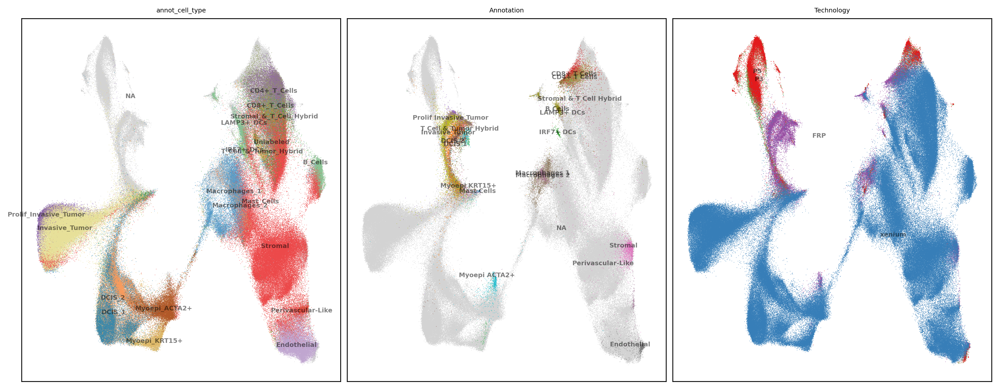

In [43]:
import concord as ccd
_, _, ct1_pal = ccd.pl.get_color_mapping(adata, 'Annotation', pal='tab10', seed=1)
_, _, ct2_pal = ccd.pl.get_color_mapping(adata, 'annot_cell_type', pal='Paired', seed=1)
_, _, batch_pal = ccd.pl.get_color_mapping(adata, 'Technology', pal='Set1', seed=1)
pal = {'annot_cell_type':ct2_pal, 'Annotation':ct1_pal, 'Technology':batch_pal}
show_basis = f'X_umap'
show_cols = ['annot_cell_type', 'Annotation', 'Technology']
ccd.pl.plot_embedding(
    adata, show_basis, show_cols, figsize=(13,5), dpi=300, ncols=3,  font_size=6, point_size=1, legend_loc='on data',
    pal=pal,
    save_path=save_dir / f"combined_embeddings_{show_basis}_{file_suffix}.png"
)

In [44]:
import concord as ccd
cur_ccd = ccd.Concord(adata=adata, 
                      latent_dim = n_latent,
                      domain_key='Technology', # key in adata.obs that contains domain labels
                      clr_temperature=0.3, # temperature for contrastive loss
                      save_dir=save_dir, # directory to save model checkpoints
                      inplace=False, # whether to modify adata in place
                      ) 

# Encode data, saving the latent embedding in adata.obsm['Concord']
output_key = 'Concord'
cur_ccd.encode_adata(input_layer_key='X', output_key=output_key, preprocess=False)
adata.obsm = cur_ccd.adata.obsm.copy()
# Save the latent embedding to a file, so that it can be loaded later
ccd.ul.save_obsm_to_hdf5(cur_ccd.adata, save_dir / f"obsm_{file_suffix}.h5")

Concord - WARNING - No input feature list provided. It is recommended to first select features using the command `concord.ul.select_features()`.


FAISS not found. Using sklearn for k-NN computation.


p_intra_knn: 0.3


Epoch 0 Training: 5278it [00:21, 249.16it/s, loss=3.18]
Epoch 9 Training: 100%|██████████| 5278/5278 [00:22<00:00, 239.54it/s, loss=2.85]


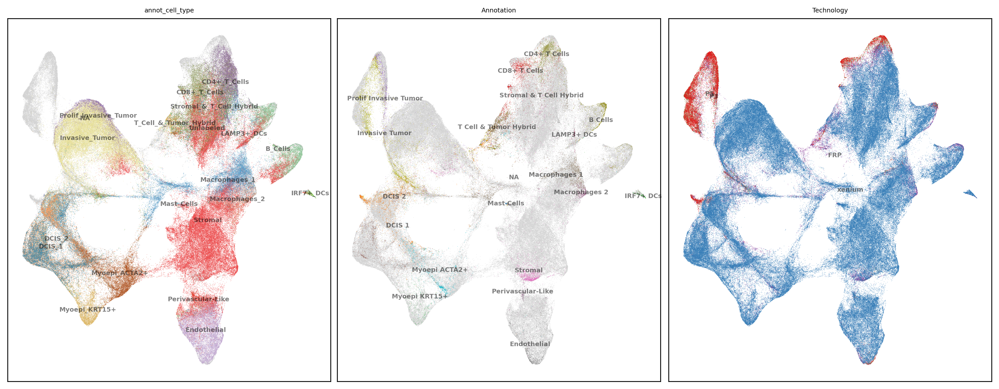

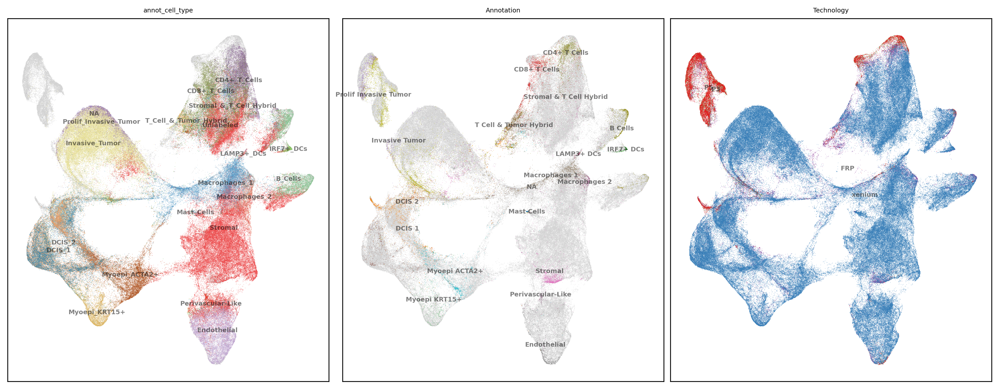

In [45]:
ccd.ul.run_umap(adata, source_key=output_key, result_key=f'{output_key}_UMAP_euc', n_components=2, n_neighbors=15, min_dist=0.1, metric='euclidean')
show_basis = f'{output_key}_UMAP_euc'
ccd.pl.plot_embedding(
    adata, show_basis, show_cols, figsize=(13,5), dpi=300, ncols=3,  font_size=6, point_size=.5, legend_loc='on data',
    pal=pal,
    save_path=save_dir / f"combined_embeddings_{show_basis}_{file_suffix}.png"
)

ccd.ul.run_umap(adata, source_key=output_key, result_key=f'{output_key}_UMAP_cos', n_components=2, n_neighbors=15, min_dist=0.1, metric='cosine')
show_basis = f'{output_key}_UMAP_cos'
ccd.pl.plot_embedding(
    adata, show_basis, show_cols, figsize=(13,5), dpi=300, ncols=3,  font_size=6, point_size=.5, legend_loc='on data',
    pal=pal,
    save_path=save_dir / f"combined_embeddings_{show_basis}_{file_suffix}.png"
)

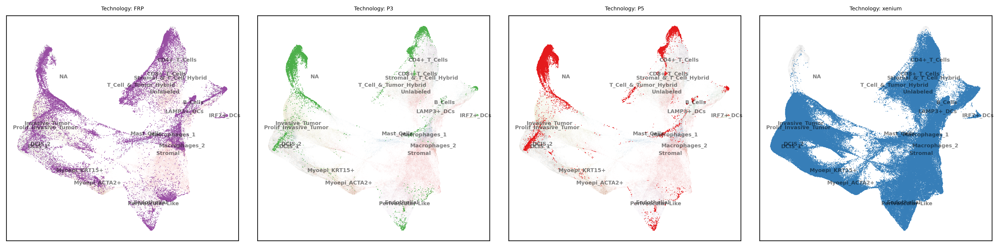

In [60]:
# plot just for each technology
fig, axs = plt.subplots(1, 4, figsize=(16,4), dpi=300)
for tech in adata.obs['Technology'].unique():
    highlight_idx = adata.obs['Technology'] == tech
    ax = axs[adata.obs['Technology'].unique().tolist().index(tech)]
    ccd.pl.plot_embedding(
        adata, show_basis, ['annot_cell_type'], dpi=300, ncols=1,  font_size=6, point_size=.3, legend_loc='on data',
        pal=pal,
        alpha=0.1,
        ax = ax,
        highlight_indices=highlight_idx,
        highlight_size=.5,
        highlight_color=pal['Technology'][tech],
        title=f"Technology: {tech}",
        save_path=None
    )
plt.tight_layout()
plt.savefig(save_dir / f"combined_embeddings_{show_basis}_by_technology_{file_suffix}.png")

In [47]:
ccd.ul.run_umap(adata, source_key=output_key, result_key=f'{output_key}_UMAP_3D_euc', n_components=3, n_neighbors=15, min_dist=0.1, metric='euclidean')
ccd.ul.run_umap(adata, source_key=output_key, result_key=f'{output_key}_UMAP_3D_cos', n_components=3, n_neighbors=15, min_dist=0.1, metric='cosine')

In [48]:
# Plot 3D UMAP
show_basis = f'{output_key}_UMAP_3D_euc'
for col in show_cols:
    ccd.pl.plot_embedding_3d(
            adata, basis=show_basis, color_by=col,
            pal = pal,
            save_path=save_dir / f'{show_basis}_{col}_{file_suffix}.html',
            point_size=1, opacity=0.8, width=1500, height=1000, static=False
        )
    
# Plot 3D UMAP
show_basis = f'{output_key}_UMAP_3D_cos'
for col in show_cols:
    ccd.pl.plot_embedding_3d(
            adata, basis=show_basis, color_by=col,
            pal = pal,
            save_path=save_dir / f'{show_basis}_{col}_{file_suffix}.html',
            point_size=1, opacity=0.8, width=1500, height=1000, static=False
        )

In [49]:
# save adata
adata.write_h5ad(data_dir / f"adata_scRNAxenium_{file_suffix}.h5ad")
print(f"Saved adata to {data_dir / f'adata_scRNAxenium_{file_suffix}.h5ad'}")
ccd.ul.anndata_to_viscello(adata, data_dir / f"cello_scRNA_scRNAxenium_{proj_name}_{file_suffix}", project_name = proj_name, organism='hsa')
print(f"Saved viscello to {data_dir / f'cello_scRNA_scRNAxenium_{proj_name}_{file_suffix}'}")


Saved adata to ../data/janesick_nature_comms_2023/adata_scRNAxenium_Jun06-1232.h5ad
VisCello project created at ../data/janesick_nature_comms_2023/cello_scRNA_scRNAxenium_janesick_nc_2023_scRNAxenium_Jun06-1232
Saved viscello to ../data/janesick_nature_comms_2023/cello_scRNA_scRNAxenium_janesick_nc_2023_scRNAxenium_Jun06-1232
